# Analysis of the Content and Style Representations

Referring to the paper, [Image Style Transfer Using Convolutional Neural Networks, by Gatys](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf), the authors discovered that the Image Style Transfer can be done by utilizing a pre-trained convolutional neural network (vgg19) to extract the content and style representations of a content and style image and use them to create a new image (See more details in the paper or this Udacity's lab [here](https://github.com/udacity/deep-learning-v2-pytorch/blob/master/style-transfer/Style_Transfer_Solution.ipynb))

I have performed an experiment to apply the Style Transfer learning in another notebook [StyleTransfer_Experiment_Results.ipynb](./StyleTransfer_Experiment_Results.ipynb). In this notebook, I will be focusing on gaining a better understanding of the **Content Representations** and **Style Representations** of the images used in the experiment




<img src='resources/vgg19_network.png' />



In short, based on the [findings](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf) described in the paper, we can extract the **Content Representation** and **Style Representations** of an image by using the image to perform a forward through a pre-trained convolutional neural network **vgg19** and get those representation by:
* **Content Representation**: Perform a forward pass with a **content image** through the network. Then, retrieve an output of the convolutional layer **conv4_2** and use it as a content representation
* **Style Representations**:  Perform a forward pass with a **style image** through the network. Then, 
  * retrieve an output of the convolutional layers **conv1_1**, **conv2_1**, **conv3_1**, **conv4_1**, **conv5_1**
  * For each layer, compute a [Gram Matrix](https://en.wikipedia.org/wiki/Gramian_matrix) and we will use this matrix as a Style Representation (It represents the idea of share in prominent styles in each feature map)

To recap on what I did in the experiment in another notebook [StyleTransfer_Experiment_Results.ipynb](./StyleTransfer_Experiment_Results.ipynb), I performed the Style Transfer process using a **content image** which is an image of a God Statue in the Grand Palace, Bangkok, Thailand, and a **style image** which is a Thai-artistic image to create a new image as shown below:

In [266]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'


import torch
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

from src.StyleTransfer import StyleTransfer
from src.internal import im_convert

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


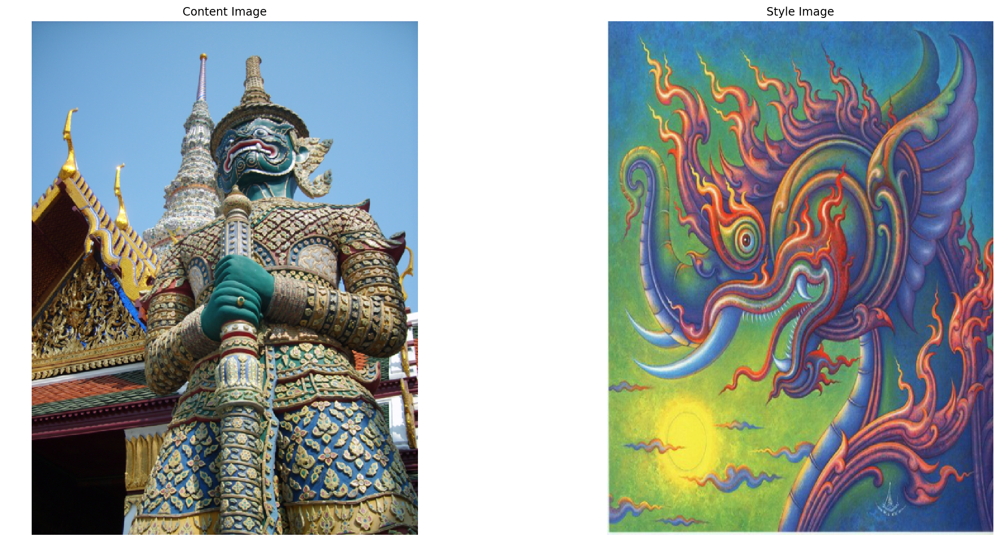

In [267]:
content_image = 'images/GodStatute_GrandPalace_Bangkok.jpg'
style_image = 'images/mah_tip.jpg'

st = StyleTransfer(content_image=content_image, style_image=style_image)
st.showInputImages()

Target Image:


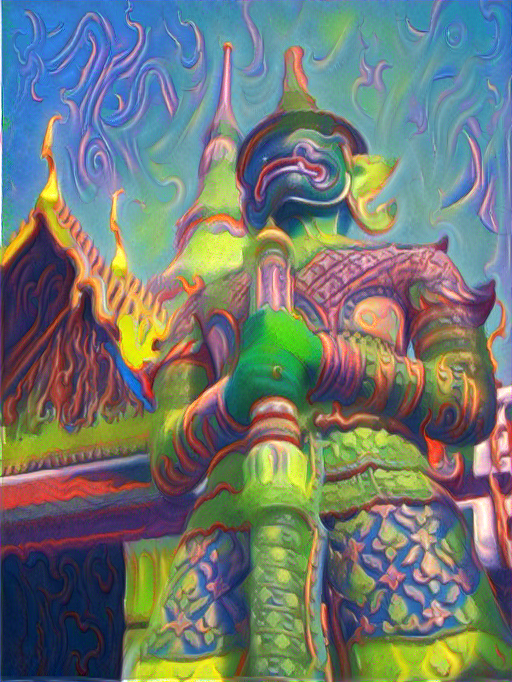

In [268]:
print('Target Image:')
target_im = Image.open('output/god_statue_small_lr.png')
target_im

## Analysis of the Content Representation

To visualize the **Content Representation** of the **content image**, we will inspect the output of the **conv4_2** layer when forward passing the content image through the vgg19 network

Note that when constructing a **StyleTransfer** object, this operation has already been done and the tensor data of the interested convolutional layers can be retrieved by accessing the **data** property of the object

In [269]:
# Inspect available data stored in the object
st.data.keys()

dict_keys(['tensor_content', 'tensor_style', 'tensor_target', 'features_content', 'features_style', 'style_grams'])

In [270]:
# Then, retrieve the output of the 'conv4_2' layer
feat_content_all = st.data['features_content']
feat_content = feat_content_all['conv4_2']
feat_content.size()

torch.Size([1, 512, 85, 64])

In [271]:
# Remove the first dimension since we don't need it
feat_content = feat_content.squeeze()
feat_content.size()

torch.Size([512, 85, 64])

In [272]:
feat_content

tensor([[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         ...,
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.4030, 0.0000, 0.0000,  ..., 0.0000, 2.7004, 0.0000]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         ...,
         [0.1584, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.7494, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [3.8032, 2.2012, 1.2477,  ..., 0.0000, 0.0000, 0.1268]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.

Content Representation - Output of each filter in the conv4_2 layer


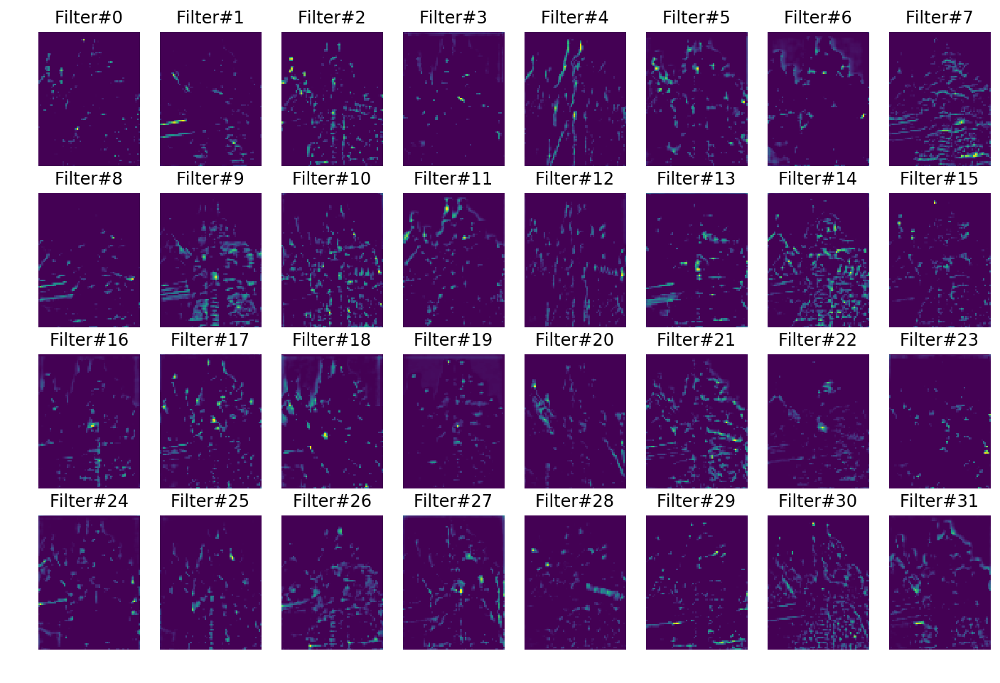

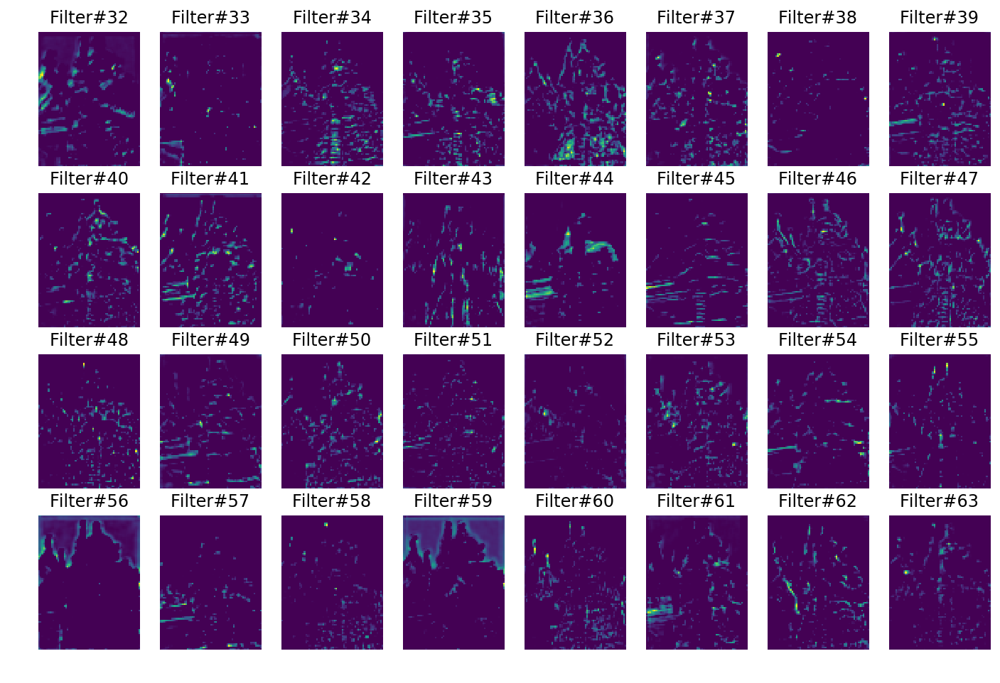

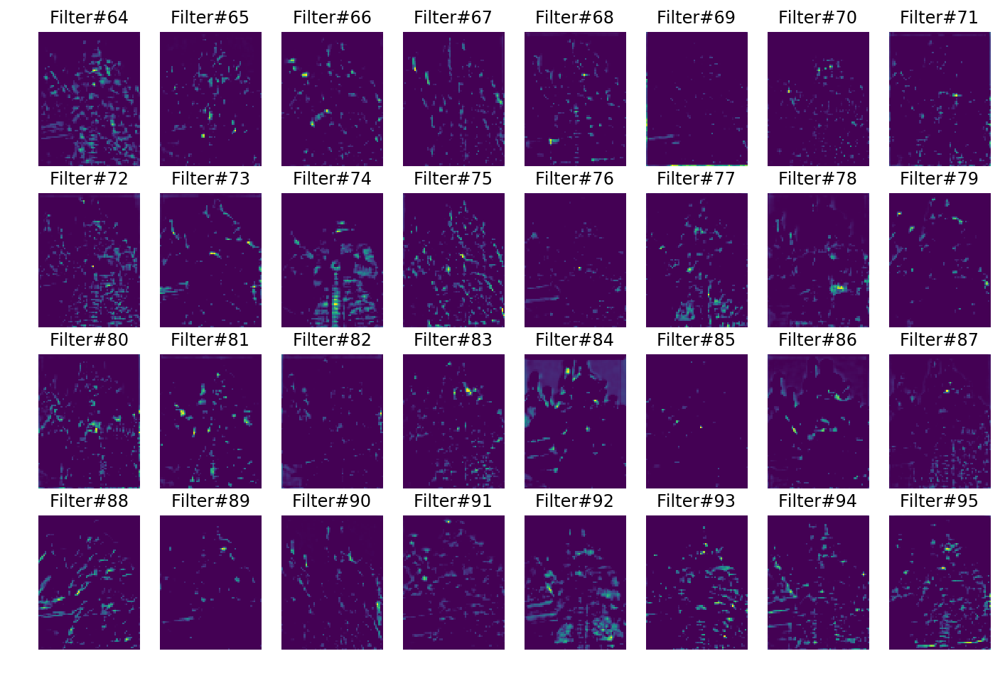

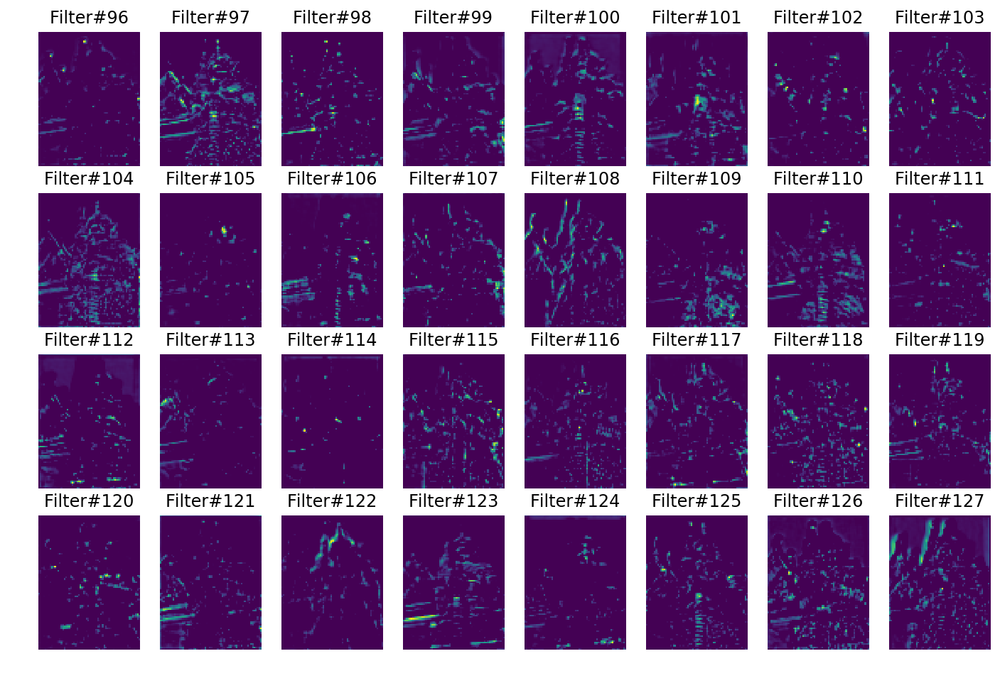

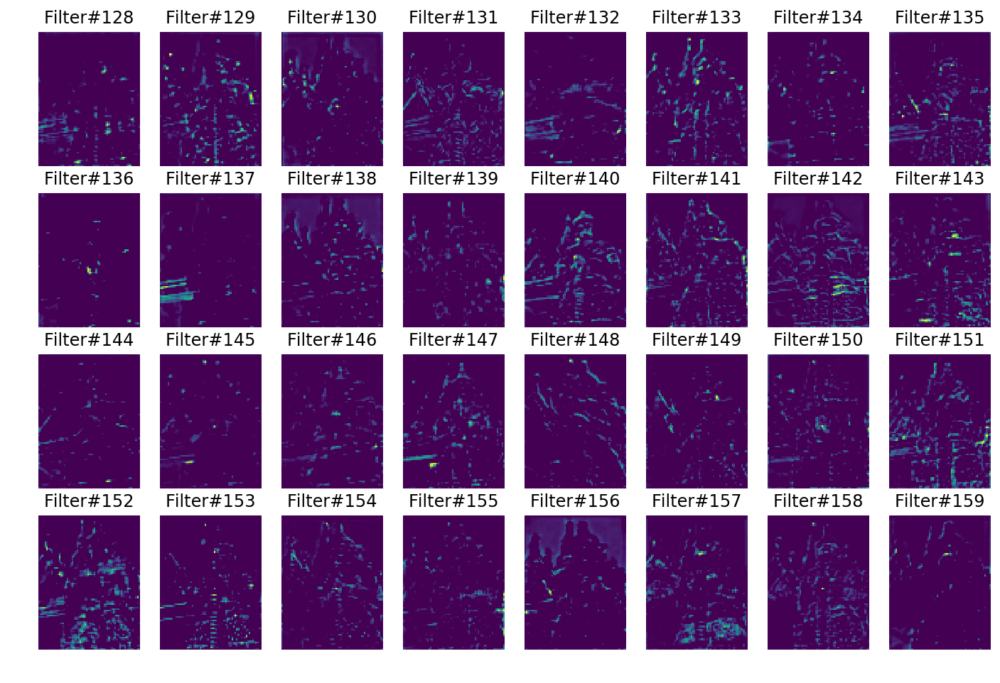

...

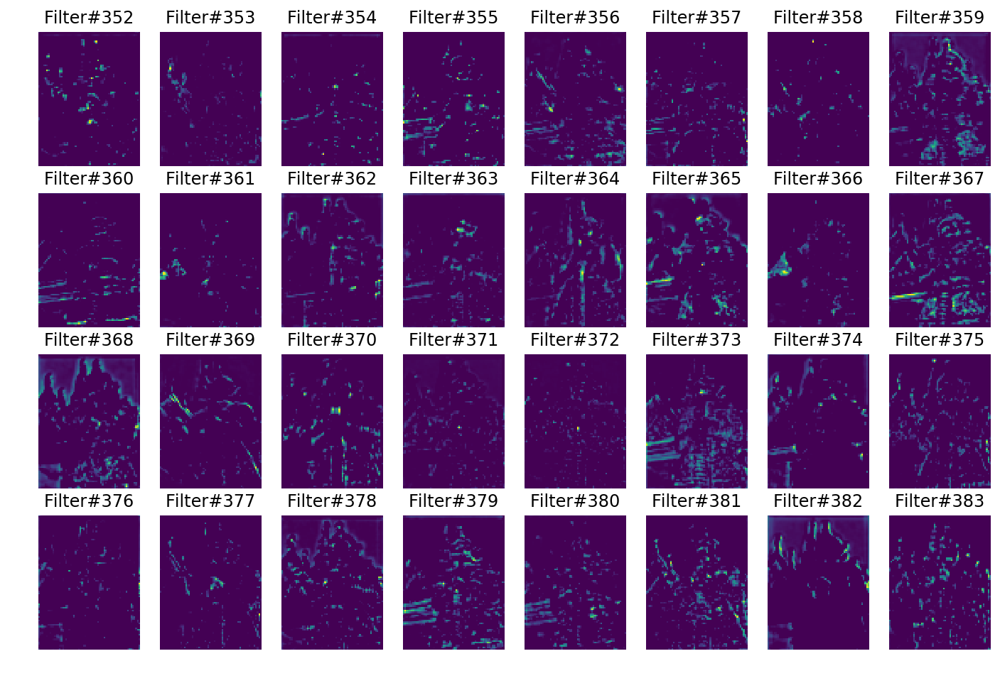

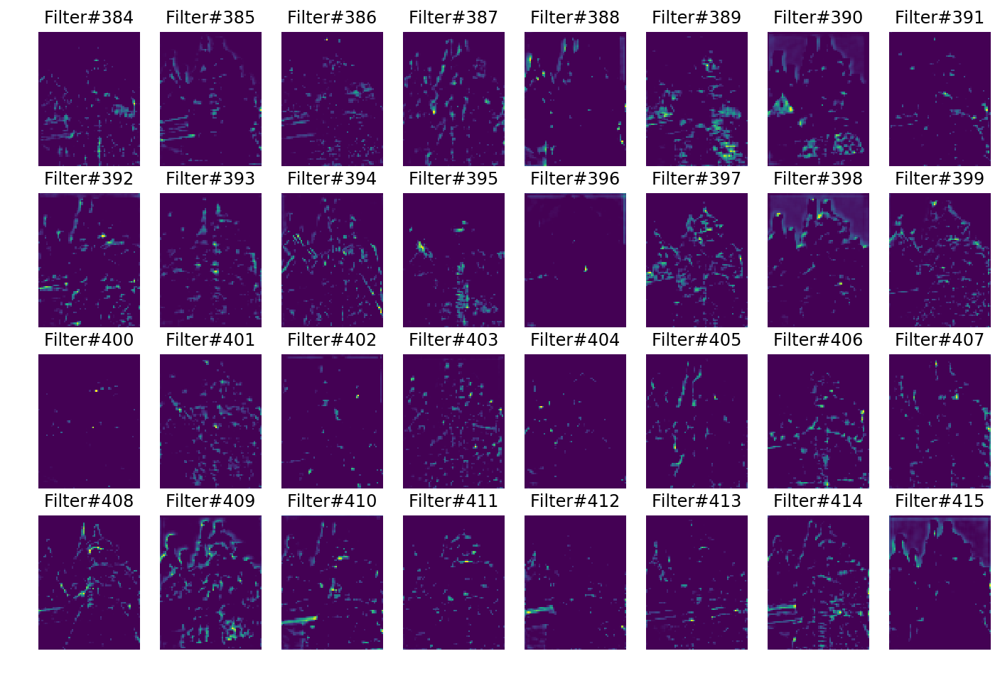

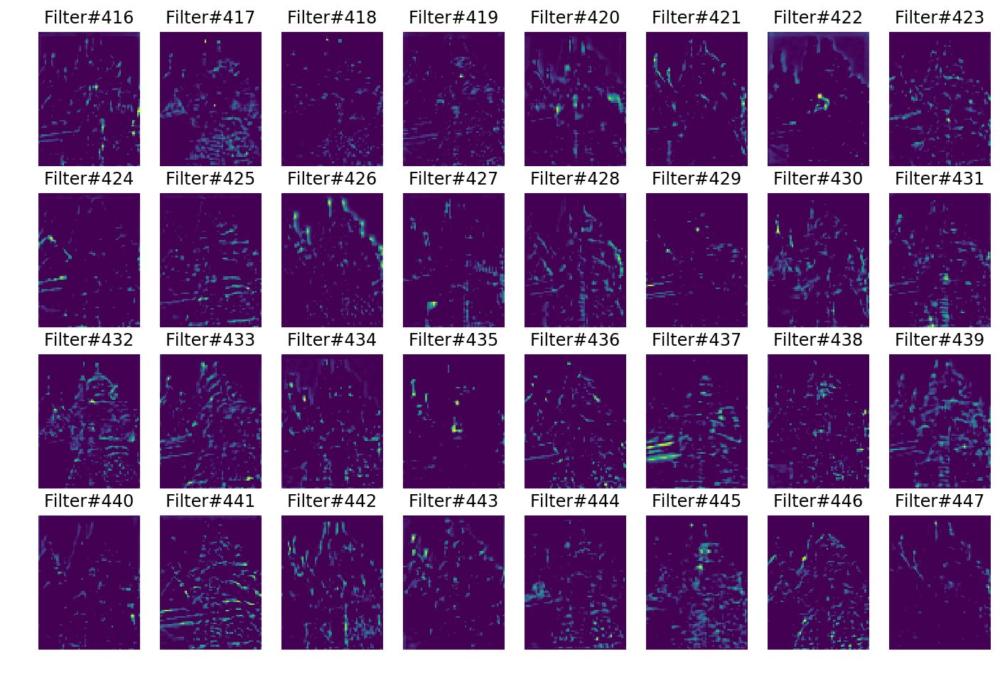

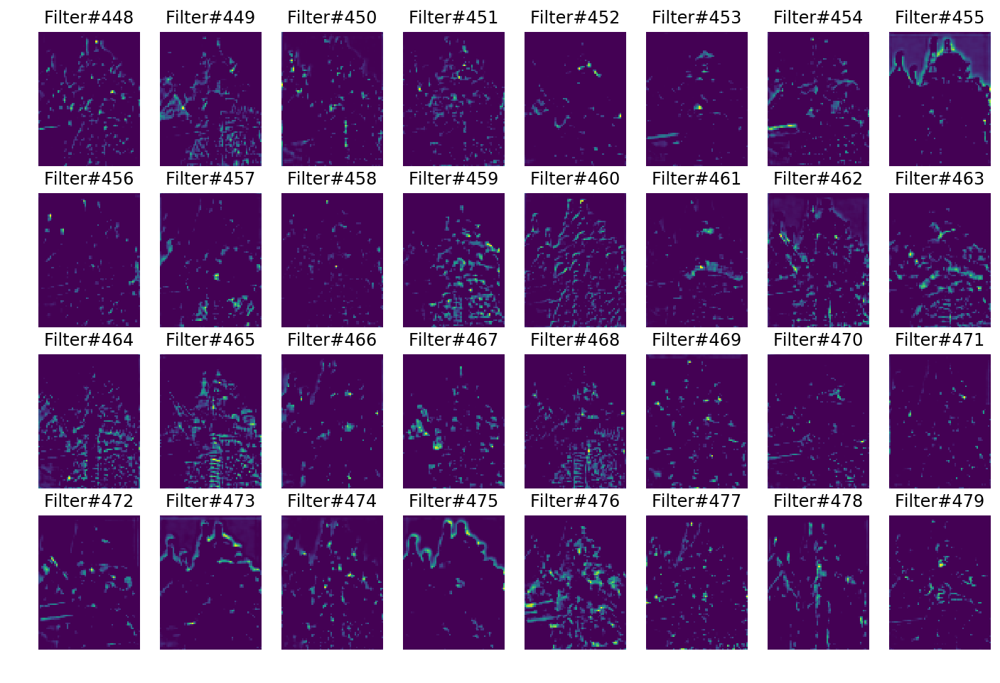

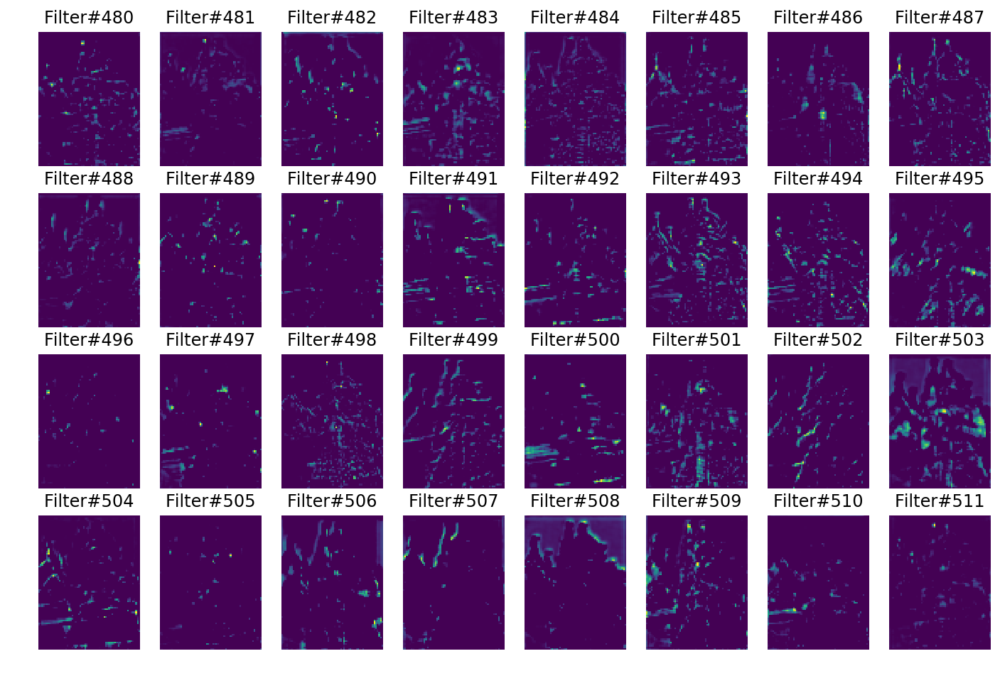

In [273]:
# Or using 
# st.showContentRepresentation()

print('Content Representation - Output of each filter in the conv4_2 layer');

num_filters, _, _ = feat_content.size()
batches =  int(num_filters / 32)

def plot_content_rep(feat_content, idx_batch):
    
    # display the images   
     
    fig, axs = plt.subplots(4, 8, figsize=(12,8), facecolor='w', edgecolor='k');
    axs = axs.ravel();

    for i in range(32):
        
        cur_filter = idx_batch*32 + i

        axs[i].imshow(feat_content[cur_filter].to("cpu").clone().detach().numpy());
        axs[i].set_title('Filter#{}'.format(cur_filter));
        axs[i].set_axis_off();


for idx_batch in range(batches):
    plot_content_rep(feat_content, idx_batch);



## Analysis of the Style Representations

In [274]:
style_grams = st.data['style_grams']

In [275]:
style_grams

{'conv1_1': tensor([[ 20186.1445,  17662.2480,  18747.7891,  ...,   4591.7324,
            6172.3379,  17084.3984],
         [ 17662.2480, 229796.2969,  16045.7061,  ..., 113822.8906,
           31240.9551, 106558.4453],
         [ 18747.7891,  16045.7061,  44846.0664,  ...,   1174.8192,
           12487.8350,  26915.5723],
         ...,
         [  4591.7324, 113822.8906,   1174.8192,  ..., 648161.8125,
           92145.4375, 133501.1562],
         [  6172.3379,  31240.9551,  12487.8350,  ...,  92145.4375,
           63765.1562,  49467.1406],
         [ 17084.3984, 106558.4453,  26915.5723,  ..., 133501.1562,
           49467.1406, 215700.7344]], device='cuda:0'),
 'conv2_1': tensor([[316412.7812,  19379.4238, 126752.6641,  ..., 131583.1250,
           99010.3359, 116919.6719],
         [ 19379.4238,  50601.4219,  15324.7578,  ...,  71526.0312,
           40577.9727,  17273.3770],
         [126752.6641,  15324.7578, 173083.6406,  ...,  77164.2188,
           39419.2539,  55382.5859],


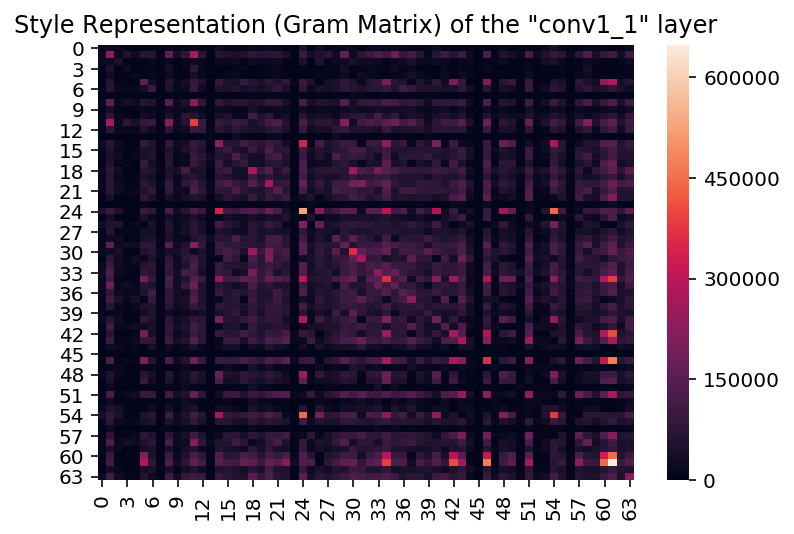

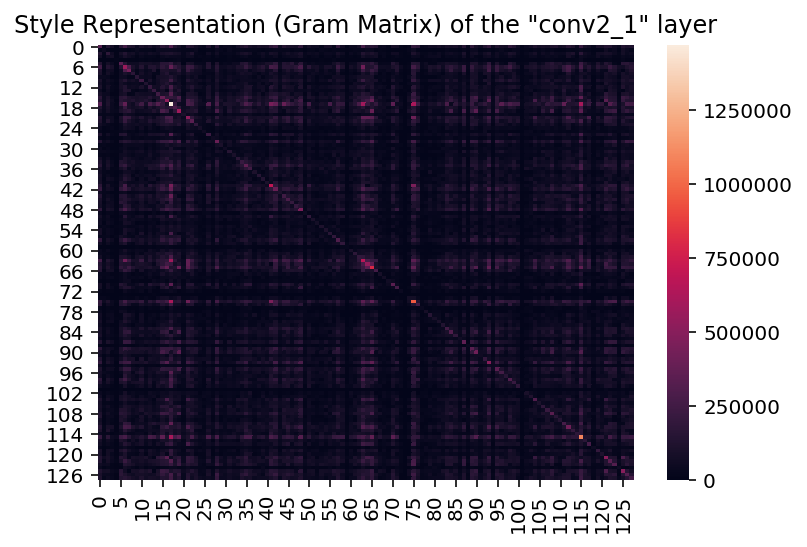

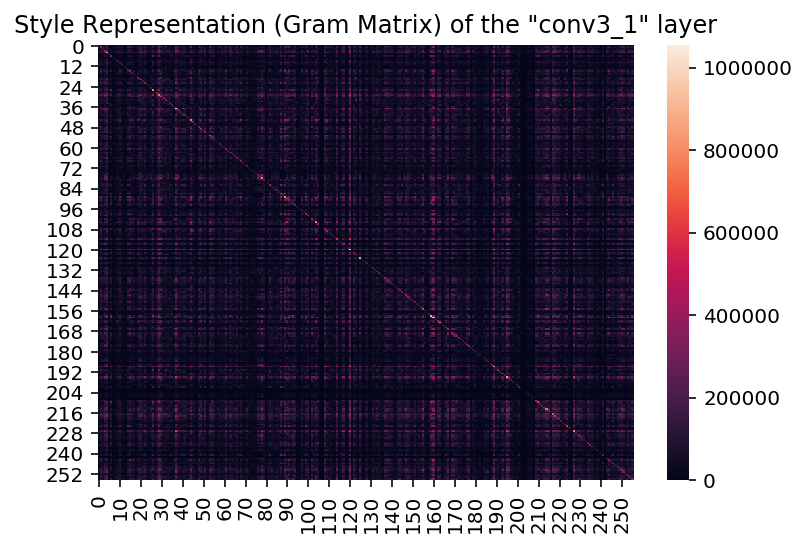

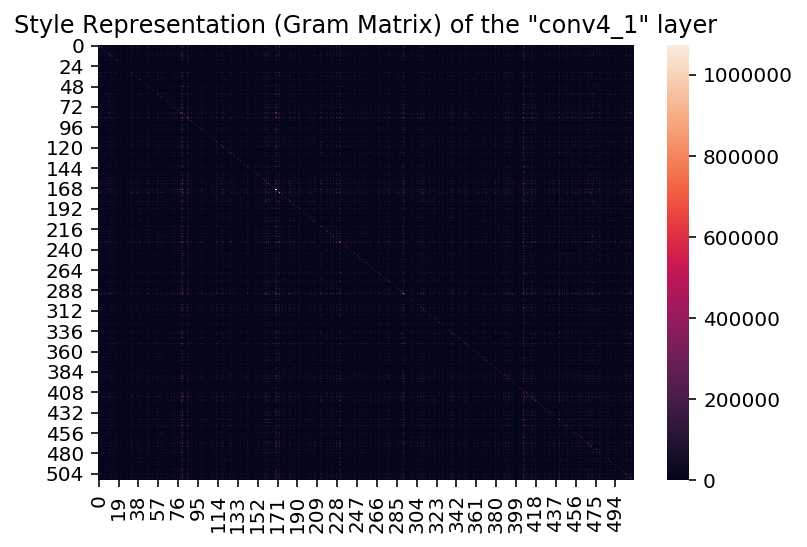

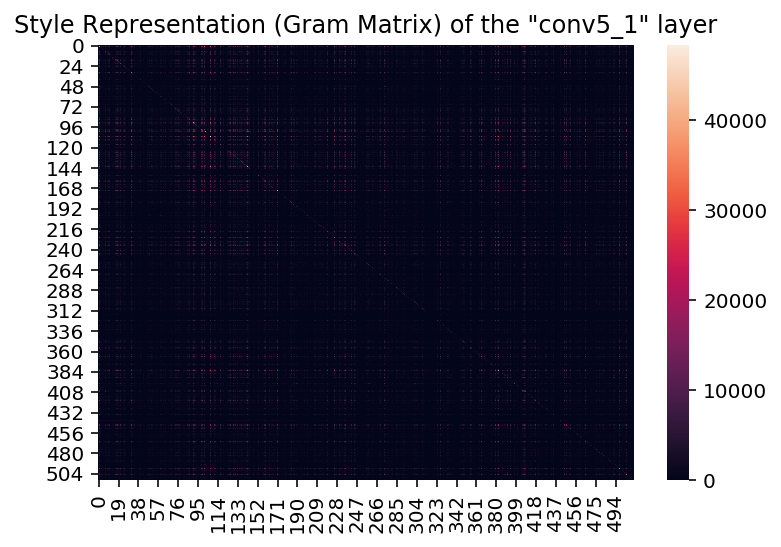

In [276]:
st.showStyleRepresentations()

Let's inspect 'conv1_1'

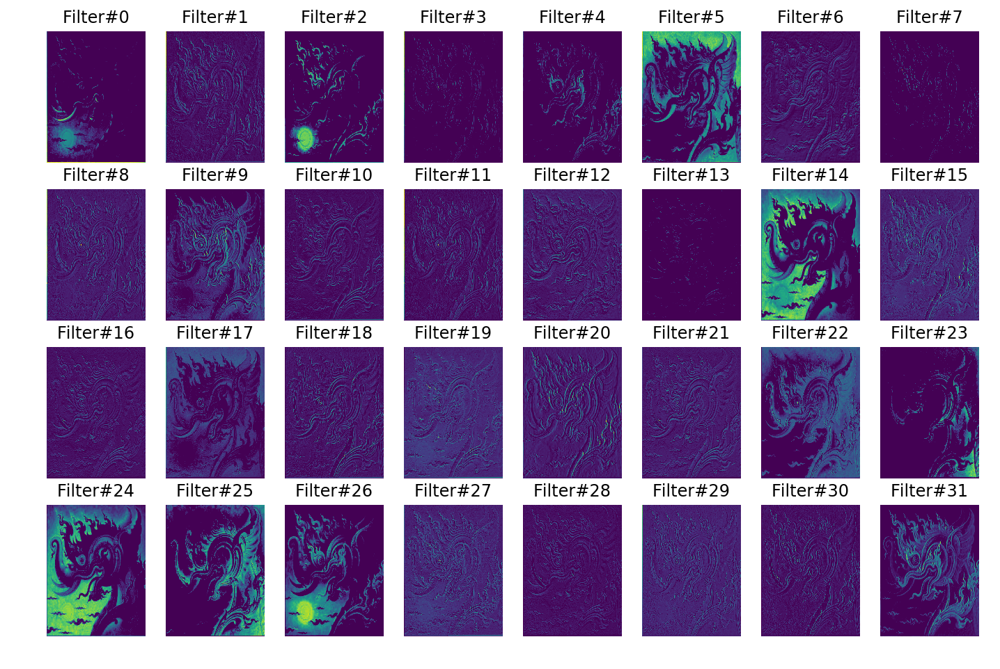

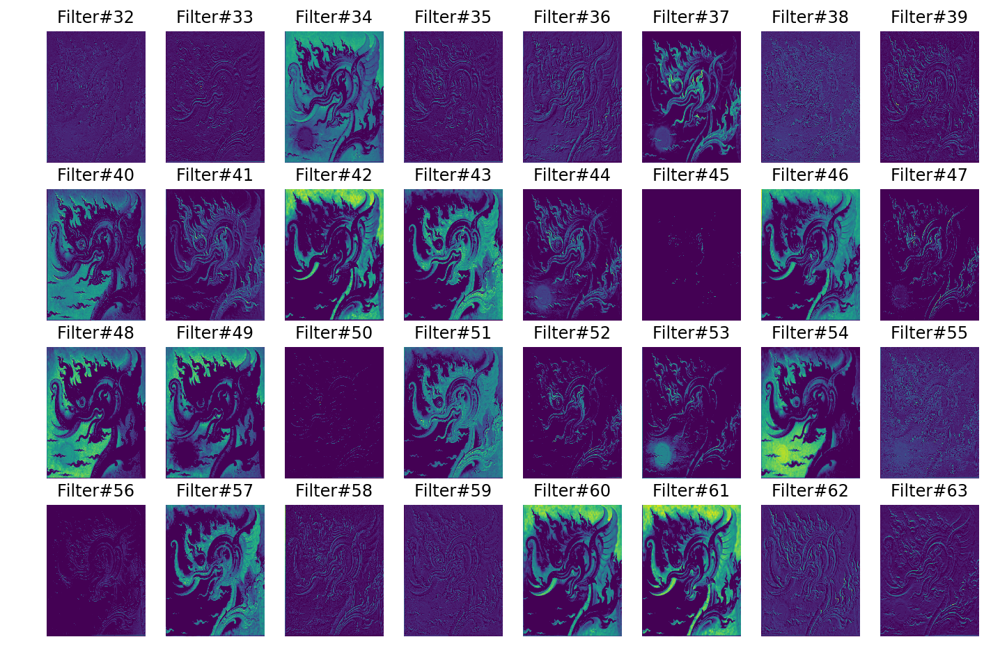

In [277]:
st.showStyleFiltersAtLayer('conv1_1')

In [278]:
st.getGramMatrixIndicesSortedDescendingly('conv1_1')

[(61, 61),
 (24, 24),
 (46, 61),
 (61, 46),
 (61, 60),
 (60, 61),
 (24, 54),
 (54, 24),
 (42, 61),
 (61, 42),
 (11, 11),
 (34, 61),
 (61, 34),
 (54, 54),
 (34, 34),
 (46, 46),
 (30, 30),
 (14, 24),
 (24, 14),
 (60, 60),
 (46, 60),
 (60, 46),
 (24, 34),
 (34, 24),
 (60, 34),
 (34, 60),
 (40, 24),
 (24, 40),
 (46, 42),
 (42, 46),
 (5, 61),
 (61, 5),
 (42, 60),
 (60, 42),
 (43, 43),
 (14, 54),
 (54, 14),
 (46, 34),
 (34, 46),
 (20, 20),
 (51, 61),
 (61, 51),
 (42, 42),
 (1, 11),
 (11, 1),
 (18, 18),
 (31, 31),
 (43, 61),
 (61, 43),
 (48, 24),
 (24, 48),
 (18, 30),
 (30, 18),
 (43, 51),
 (51, 43),
 (42, 34),
 (34, 42),
 (51, 51),
 (40, 54),
 (54, 40),
 (14, 14),
 (14, 34),
 (34, 14),
 (37, 37),
 (1, 1),
 (34, 54),
 (54, 34),
 (57, 61),
 (61, 57),
 (46, 51),
 (51, 46),
 (33, 33),
 (11, 8),
 (8, 11),
 (29, 11),
 (11, 29),
 (60, 5),
 (5, 60),
 (26, 24),
 (24, 26),
 (46, 43),
 (43, 46),
 (63, 63),
 (11, 58),
 (58, 11),
 (5, 46),
 (46, 5),
 (61, 22),
 (22, 61),
 (48, 54),
 (54, 48),
 (40, 34),


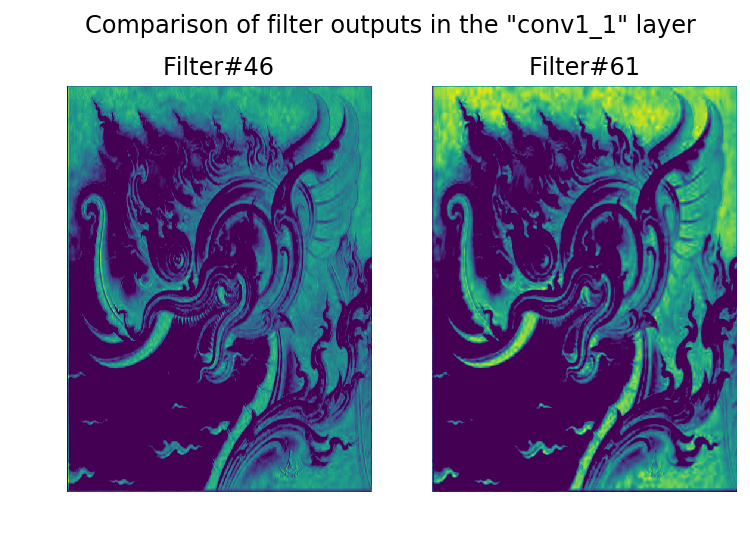

In [279]:
showStyleFilterComparison('conv1_1', 46, 61)

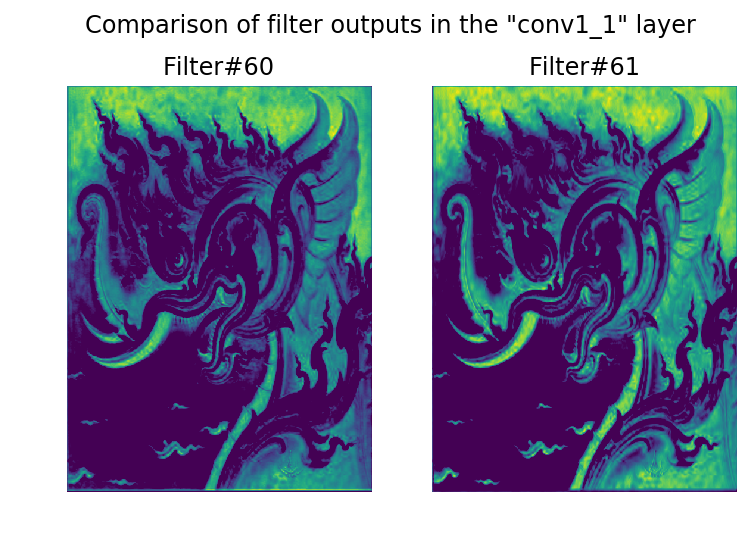

In [280]:
showStyleFilterComparison('conv1_1', 60, 61)

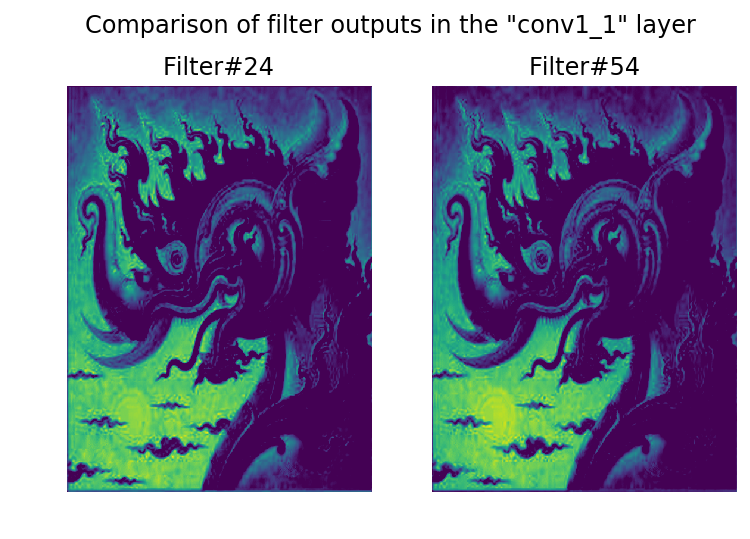

In [281]:
showStyleFilterComparison('conv1_1', 24, 54)

Let's inspect 'conv2_1'

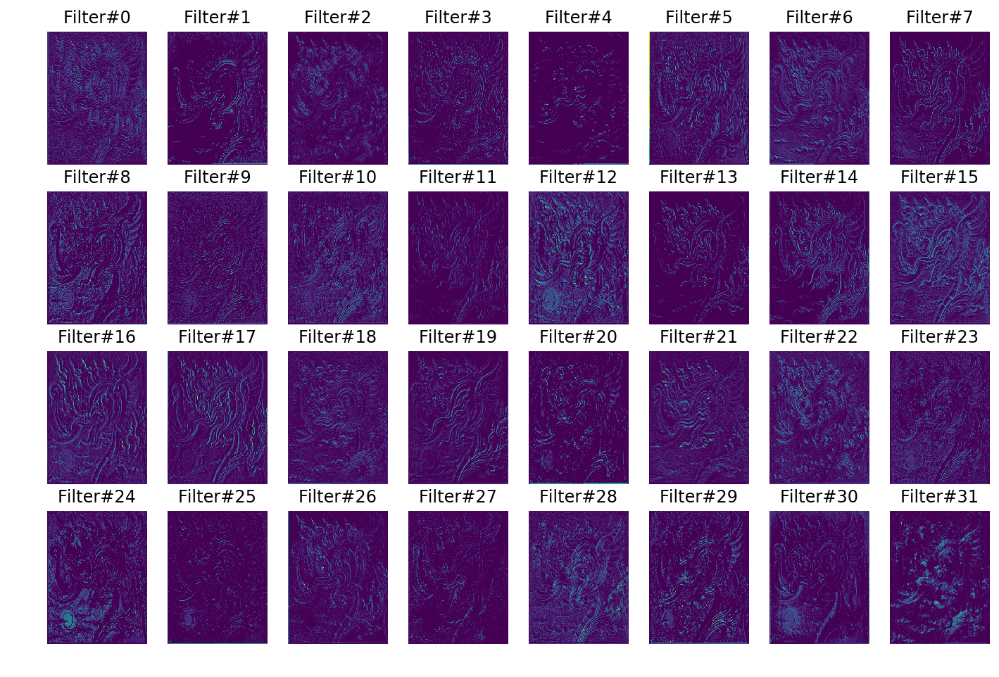

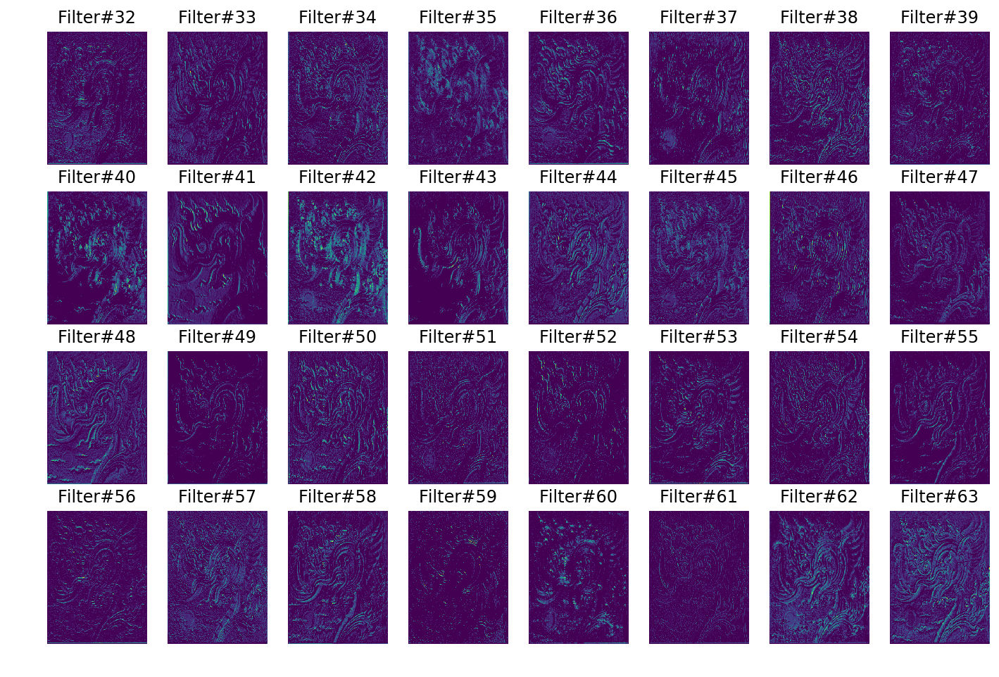

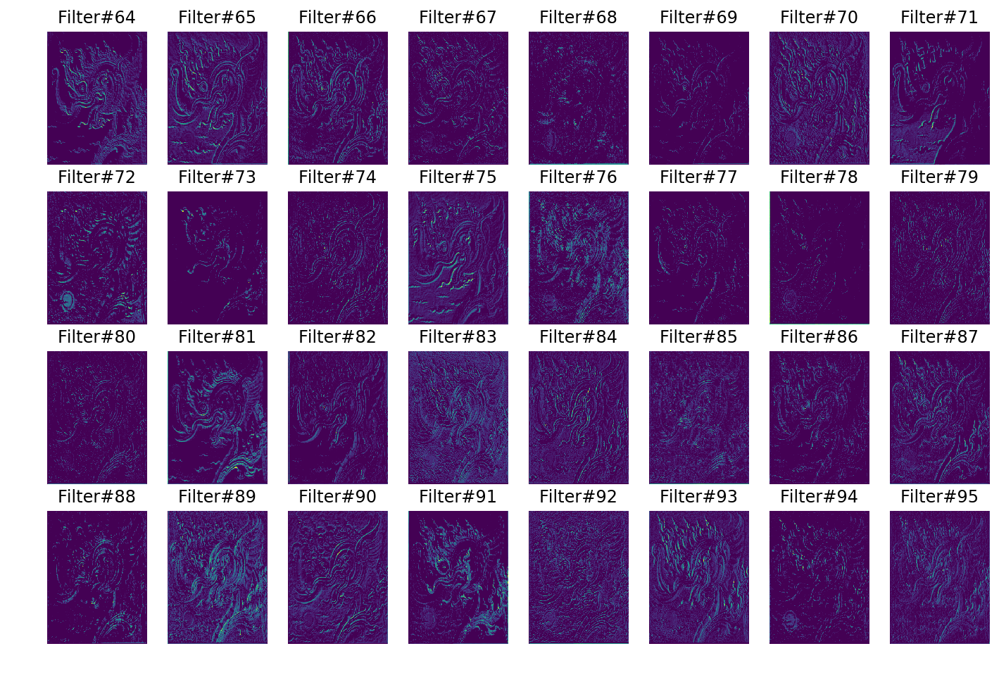

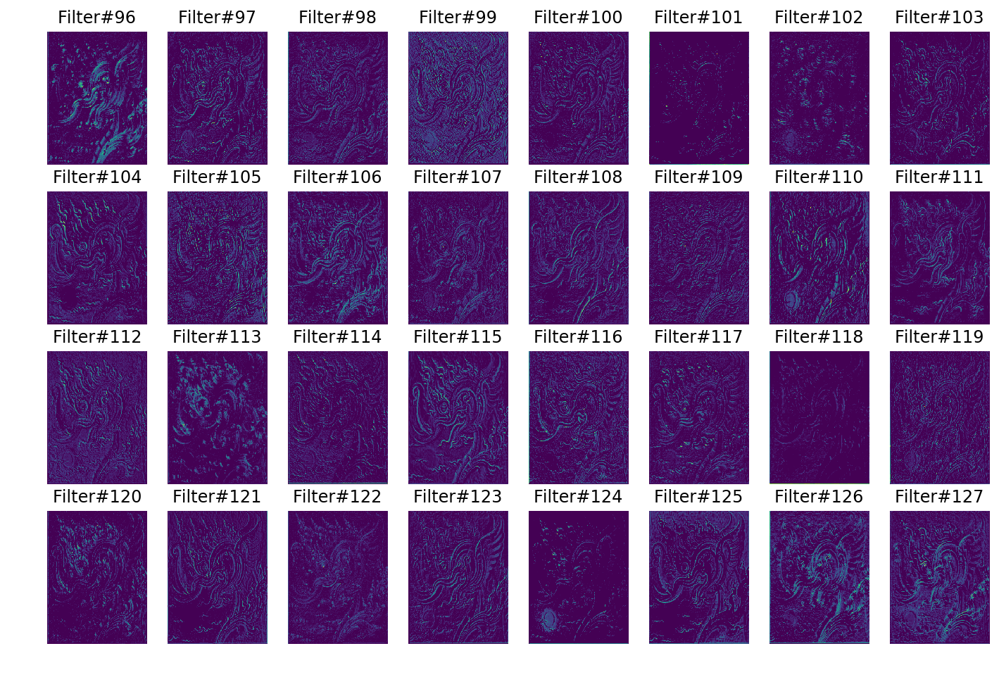

In [282]:
st.showStyleFiltersAtLayer('conv2_1')

In [283]:
st.getGramMatrixIndicesSortedDescendingly('conv2_1')

[(17, 17),
 (115, 115),
 (75, 75),
 (65, 65),
 (41, 41),
 (63, 63),
 (17, 75),
 (75, 17),
 (17, 115),
 (115, 17),
 (17, 63),
 (63, 17),
 (19, 19),
 (6, 6),
 (64, 64),
 (16, 16),
 (21, 21),
 (121, 121),
 (93, 93),
 (125, 125),
 (48, 48),
 (41, 75),
 (75, 41),
 (17, 41),
 (41, 17),
 (7, 7),
 (112, 112),
 (90, 90),
 (6, 63),
 (63, 6),
 (75, 21),
 (21, 75),
 (28, 28),
 (44, 17),
 (17, 44),
 (15, 15),
 (65, 19),
 (19, 65),
 (42, 42),
 (16, 65),
 (65, 16),
 (42, 17),
 (17, 42),
 (6, 17),
 (17, 6),
 (63, 21),
 (21, 63),
 (35, 35),
 (65, 93),
 (93, 65),
 (115, 65),
 (65, 115),
 (111, 17),
 (17, 111),
 (21, 64),
 (64, 21),
 (115, 15),
 (15, 115),
 (75, 65),
 (65, 75),
 (87, 87),
 (17, 70),
 (70, 17),
 (115, 19),
 (19, 115),
 (70, 115),
 (115, 70),
 (65, 64),
 (64, 65),
 (63, 75),
 (75, 63),
 (19, 90),
 (90, 19),
 (95, 95),
 (89, 89),
 (22, 22),
 (16, 121),
 (121, 16),
 (96, 17),
 (17, 96),
 (65, 21),
 (21, 65),
 (122, 122),
 (70, 70),
 (108, 108),
 (5, 5),
 (115, 48),
 (48, 115),
 (26, 17),
 (1

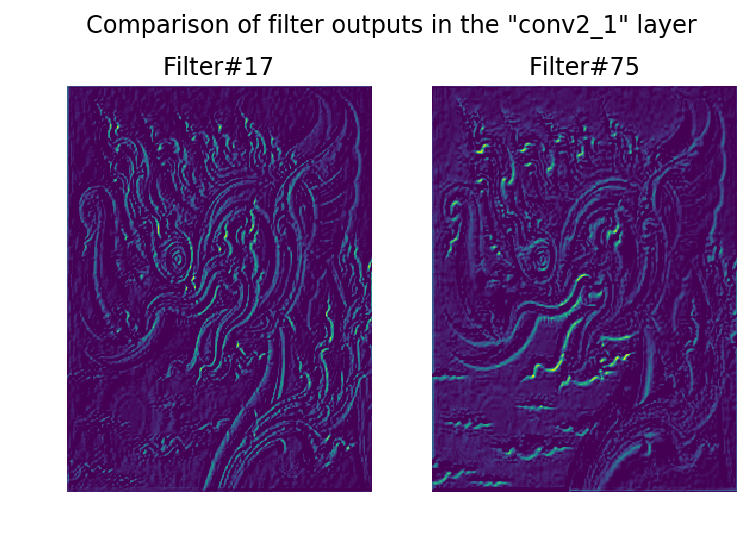

In [284]:
showStyleFilterComparison('conv2_1', 17, 75)

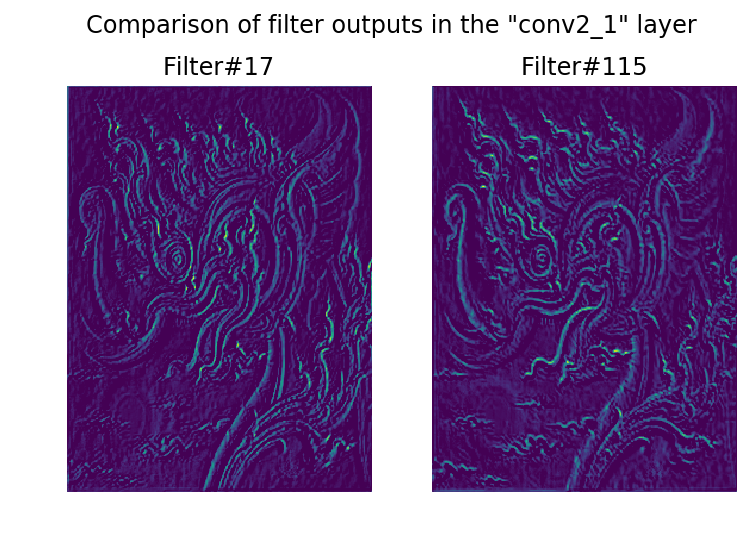

In [285]:
showStyleFilterComparison('conv2_1', 17, 115)

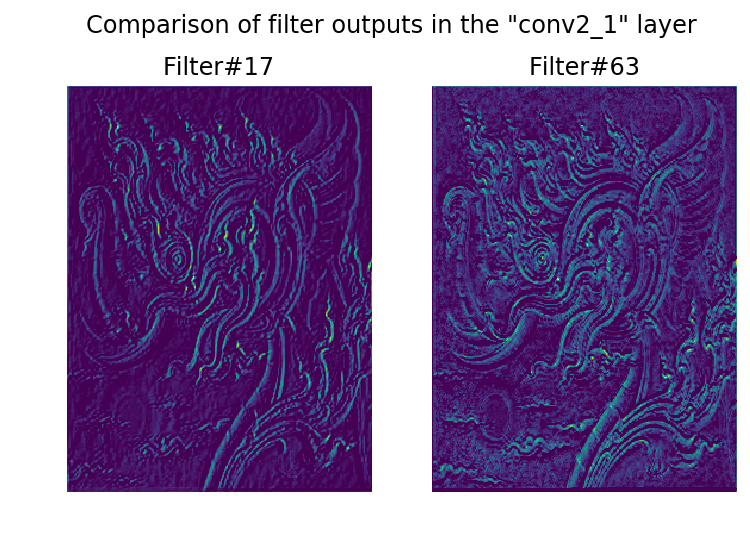

In [286]:
showStyleFilterComparison('conv2_1', 17, 63)

Let's inspect 'conv3_1'

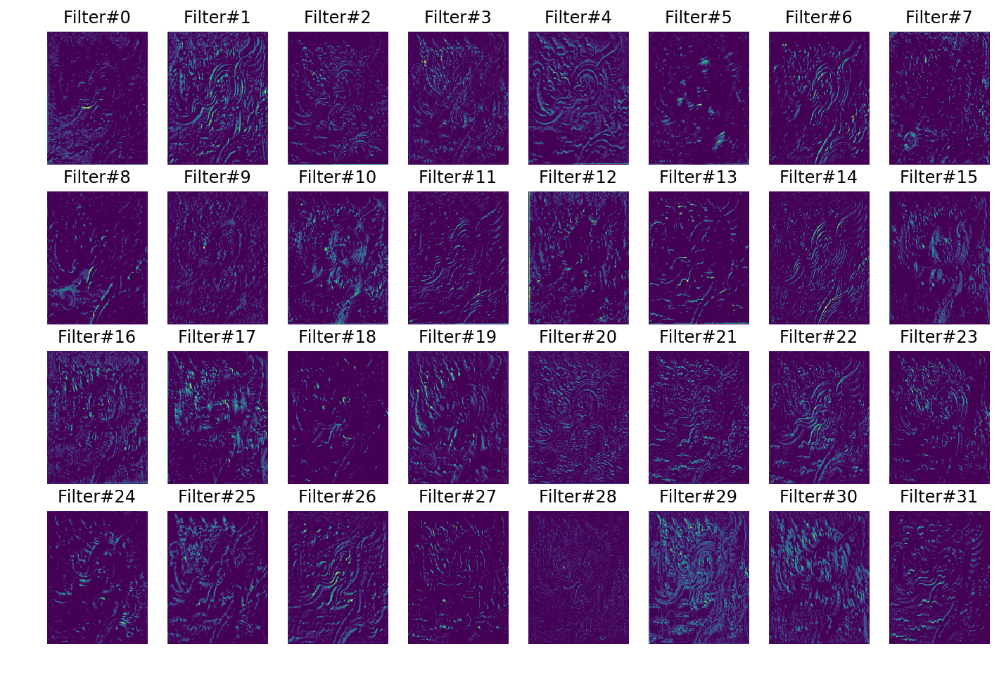

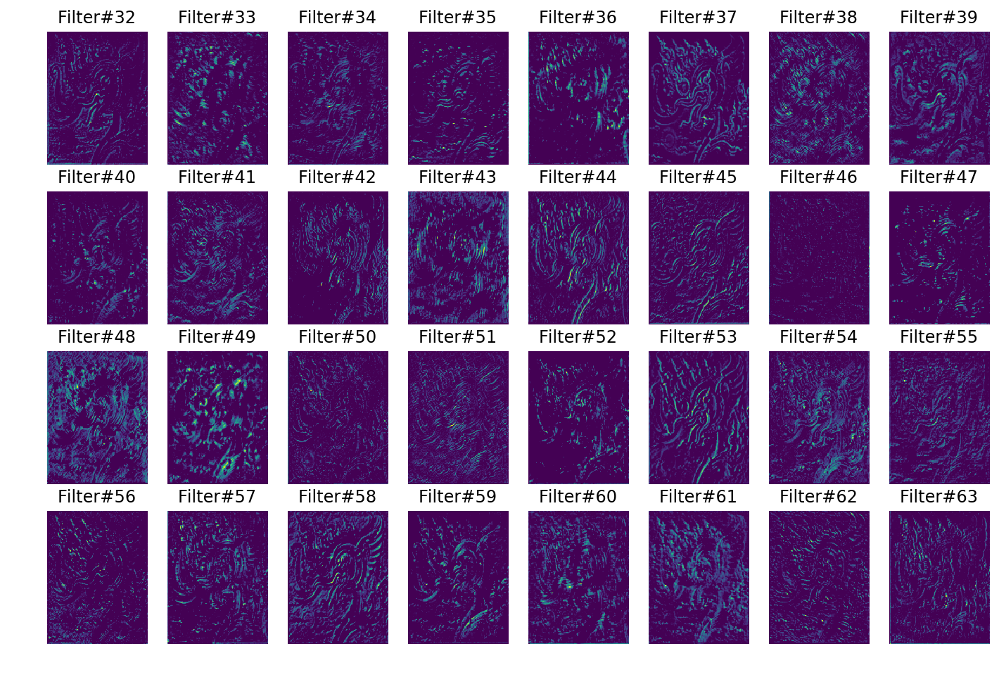

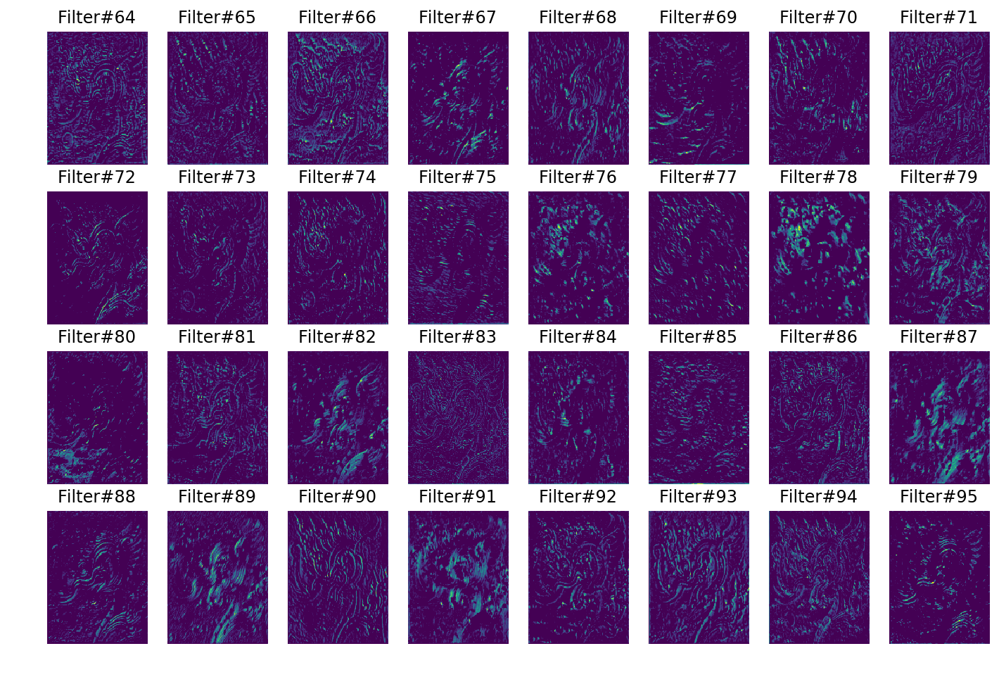

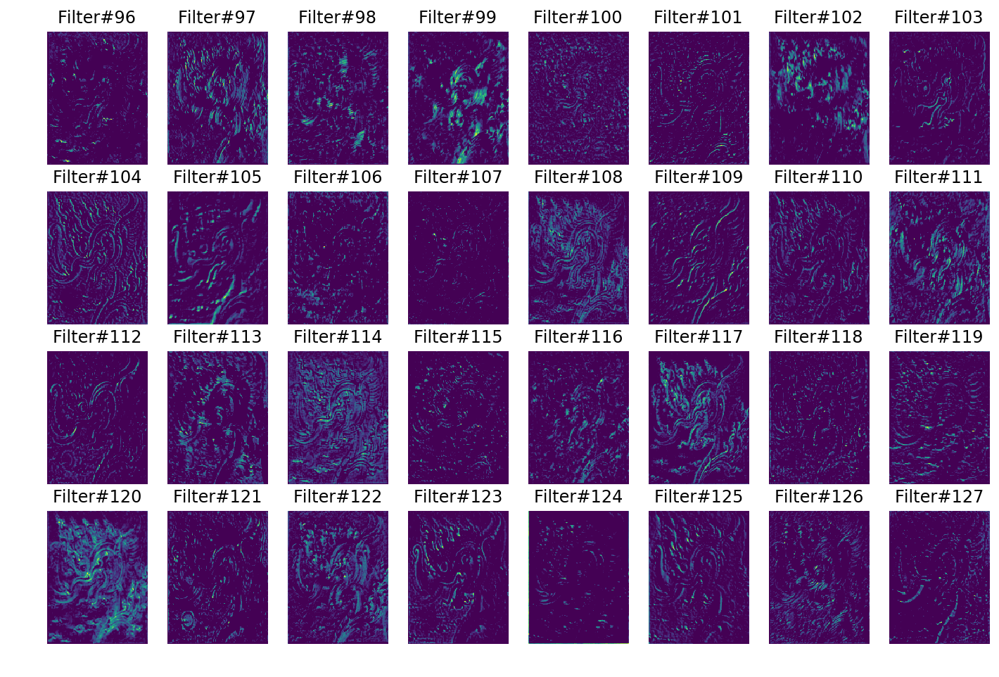

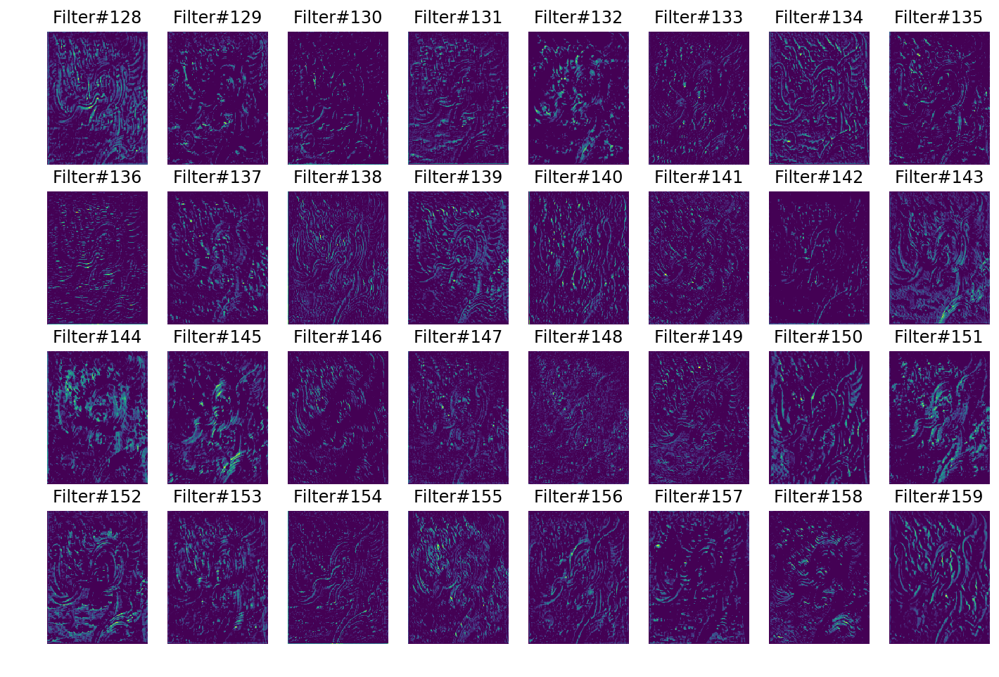

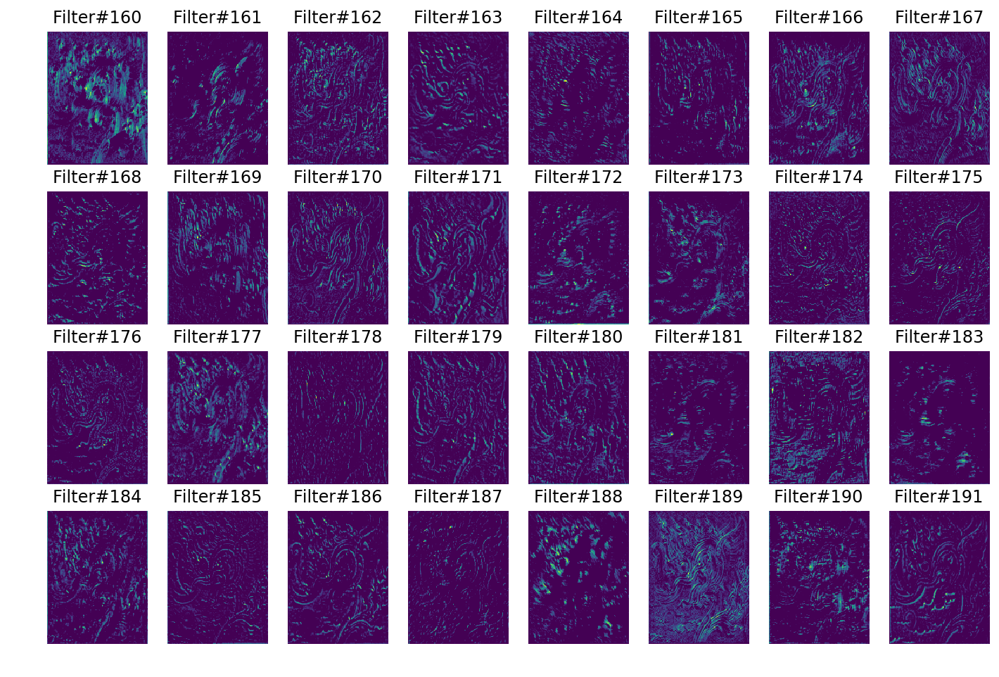

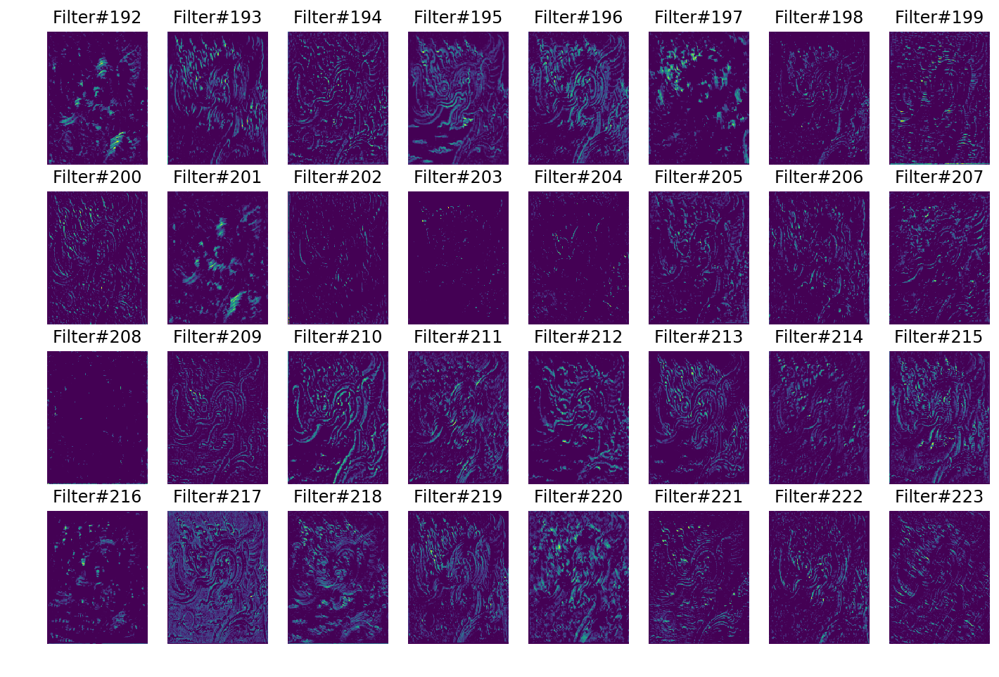

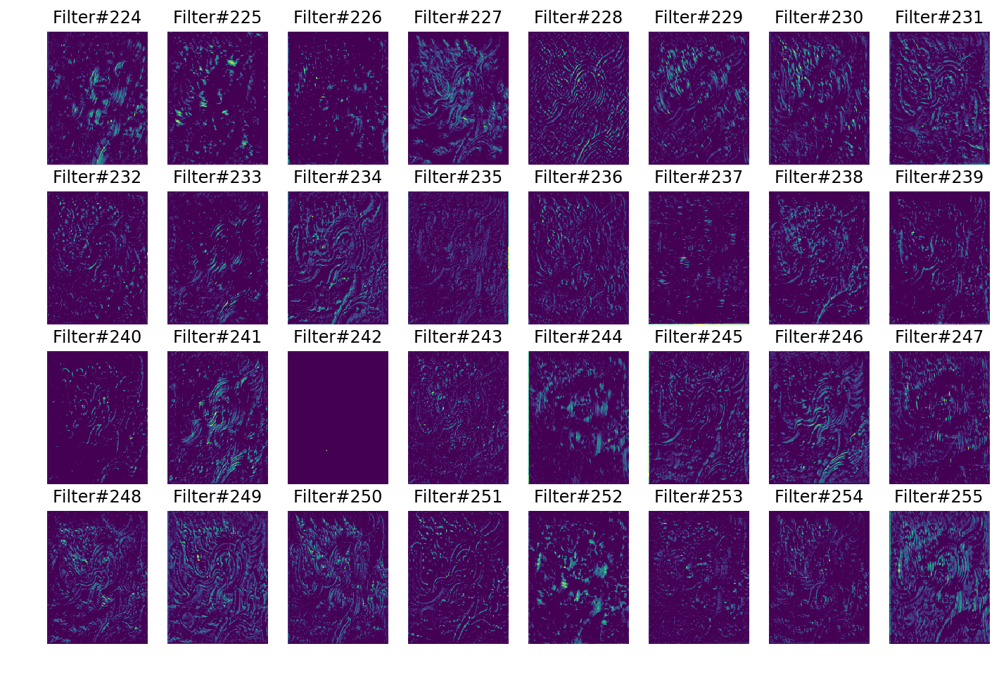

In [287]:
st.showStyleFiltersAtLayer('conv3_1')

In [288]:
st.getGramMatrixIndicesSortedDescendingly('conv3_1')

[(37, 37),
 (120, 120),
 (160, 160),
 (159, 159),
 (195, 195),
 (4, 4),
 (125, 125),
 (189, 189),
 (78, 78),
 (89, 89),
 (163, 163),
 (227, 227),
 (44, 44),
 (26, 26),
 (104, 104),
 (214, 214),
 (29, 29),
 (217, 217),
 (120, 189),
 (189, 120),
 (155, 155),
 (210, 210),
 (227, 37),
 (37, 227),
 (53, 53),
 (90, 90),
 (224, 224),
 (218, 218),
 (227, 195),
 (195, 227),
 (30, 30),
 (114, 114),
 (120, 227),
 (227, 120),
 (195, 37),
 (37, 195),
 (114, 120),
 (120, 114),
 (209, 209),
 (87, 87),
 (120, 29),
 (29, 120),
 (90, 104),
 (104, 90),
 (253, 253),
 (120, 37),
 (37, 120),
 (170, 170),
 (147, 147),
 (167, 167),
 (169, 169),
 (123, 123),
 (105, 105),
 (250, 250),
 (244, 160),
 (160, 244),
 (160, 120),
 (120, 160),
 (3, 3),
 (137, 137),
 (120, 195),
 (195, 120),
 (160, 91),
 (91, 160),
 (120, 4),
 (4, 120),
 (160, 189),
 (189, 160),
 (196, 196),
 (104, 120),
 (120, 104),
 (251, 251),
 (49, 49),
 (108, 108),
 (120, 44),
 (44, 120),
 (120, 217),
 (217, 120),
 (109, 109),
 (29, 227),
 (227, 29

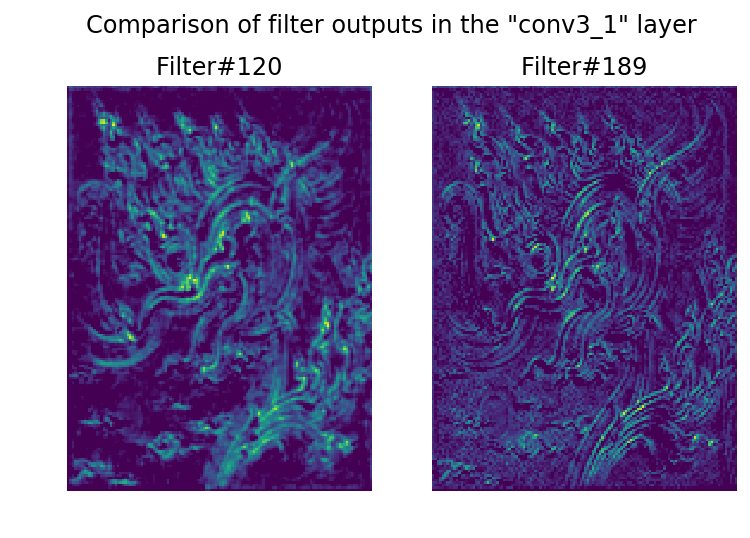

In [289]:
showStyleFilterComparison('conv3_1', 120, 189)

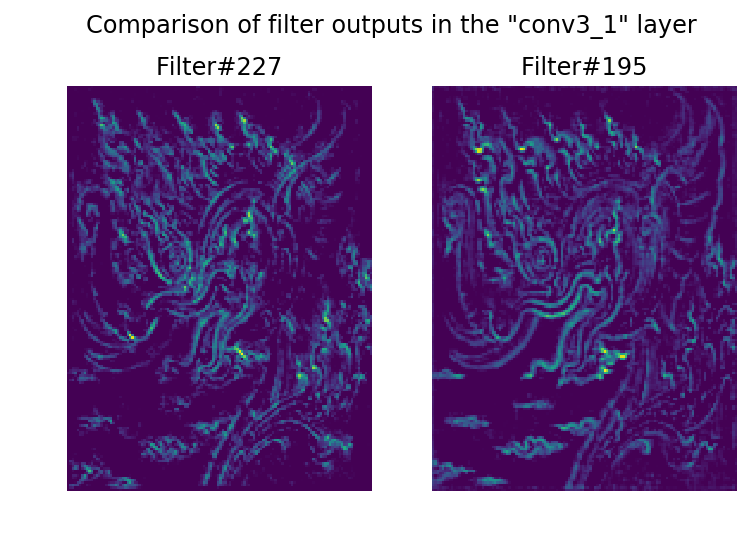

In [290]:
showStyleFilterComparison('conv3_1', 227, 195)

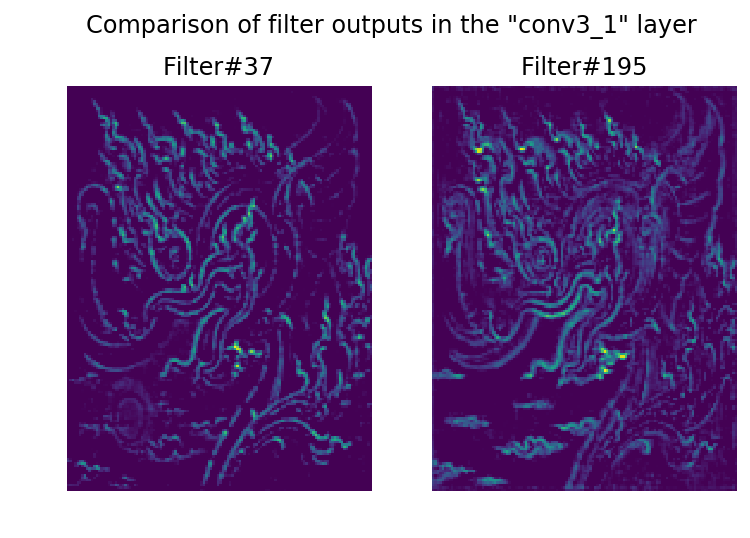

In [291]:
showStyleFilterComparison('conv3_1', 37, 195)